# Simple Data Preparation and Feature Analysis of DAiSEE from OpenFace2.0
1. Extract Non-averaged data (moving average every 30 frames)
2. Extract Feature Each subject
3. Extract EmotiW
4. Plot the selected features from all videos to see the signal trend 

In [1]:
import numpy as np
import pandas as pd
import pickle
import glob
import os
from os import walk
from datetime import datetime

from sklearn.preprocessing import MinMaxScaler

import seaborn as sns

from scipy import stats

%matplotlib inline
# %matplotlib notebook

In [5]:
path_daisee = ('../../Dataset/DAiSEE/OpenFace_2.2.0_win_x64/processed/csv/')
path_emotiw = ('../../Dataset/EmotiW/Engagement recognition/01. Train and validation/')
df_feat = pd.read_csv(path_daisee+'csv_train/181374016.csv') #Load a feature sample
print(df_feat.head())

features31 = [5,6,7,8,9,10,11,12,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315]
features311 = list(range(5,316))

# REMOVE SPACES FROM COLUMN NAMES
df = pd.DataFrame(df_feat)
df.columns = df.columns.str.replace(' ','')

#for num, col_name in enumerate(df.columns):
#    print(num, col_name)

         x1        y1        z1        v1        x2        y2        z2  \
0  0.523971  0.533872 -1.908773  0.999742  0.571097  0.431994 -1.866758   
1  0.524174  0.537533 -2.090172  0.999715  0.571557  0.434360 -2.040021   
2  0.524304  0.539003 -2.133460  0.999699  0.571813  0.435144 -2.078291   
3  0.524925  0.539132 -2.094648  0.999682  0.572577  0.435155 -2.041027   
4  0.525810  0.539153 -2.093631  0.999658  0.573347  0.435175 -2.043070   

         v2        x3        y3  ...      z499  v499      x500      y500  \
0  0.999561  0.599847  0.429569  ... -0.009661   0.0  0.630984  0.413220   
1  0.999556  0.600540  0.431401  ... -0.008003   0.0  0.631144  0.409619   
2  0.999562  0.600965  0.431901  ... -0.006881   0.0  0.632801  0.405910   
3  0.999564  0.601982  0.431910  ... -0.006739   0.0  0.634420  0.401068   
4  0.999551  0.602889  0.431945  ... -0.005839   0.0  0.635701  0.396488   

       z500  v500      x501      y501      z501  v501  
0  0.014495   0.0  0.637605  0.40580

In [7]:
# print(df_feat.columns[5:316])
print(df_feat.columns)

Index(['x1', 'y1', 'z1', 'v1', 'x2', 'y2', 'z2', 'v2', 'x3', 'y3',
       ...
       'z499', 'v499', 'x500', 'y500', 'z500', 'v500', 'x501', 'y501', 'z501',
       'v501'],
      dtype='object', length=2004)


# Extract Non-Average data

In [10]:
def load_all_data(datapath,labelfile,colnum):
    df = pd.read_csv(labelfile) #load label
    
    #create empty list
    data_list = []
    label_list = []
    
    for noid, clipid in enumerate(df.ClipID):
        temp_df = pd.read_csv(datapath+clipid, nrows=300) #read csv files (n timestamps)
        temp_df = temp_df.groupby(np.arange(len(temp_df))//30).mean() #average every 30 frames, resulting 10 timesteps
        temp_df = temp_df.iloc[:,colnum] #select features 
    
        temp_df = np.array(temp_df)
        data_list.append(temp_df)
        labl = df.Engagement[noid] 
        labl = np.array(labl)
        label_list.append(labl)    
    
    X = np.array(data_list) #features
    Y = np.array(label_list) #labels
    print('X shape:{}, Y shape:{}'.format(X.shape,Y.shape))
    
    return X, Y

### Load dataset and selected features (DAiSEE)

In [4]:
# EXTRACT each feature (Follow Chang et al.)
tic = datetime.now()
X_train, Y_train = load_all_data(path_daisee+'csv_train/',path_daisee+'labels/TrainLabels.csv',[5,6,7,8,9,10,11,12,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315])
X_val, Y_val = load_all_data(path_daisee+'csv_val/',path_daisee+'labels/ValidationLabels.csv',[5,6,7,8,9,10,11,12,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315])
X_test, Y_test = load_all_data(path_daisee+'csv_test/',path_daisee+'labels/TestLabels.csv',[5,6,7,8,9,10,11,12,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315])
time = datetime.now() - tic
print('Processing time {}'.format(time))

X shape:(5467, 20, 31), Y shape:(5467,)
X shape:(1703, 20, 31), Y shape:(1703,)
X shape:(1782, 20, 31), Y shape:(1782,)
Processing time 0:03:14.193120


In [5]:
# EXTRACT ALL features except AU precense (311 features)
li = list(range(5,316))
# print(df_feat.iloc[:,li])

tic = datetime.now()
X_train, Y_train = load_all_data(path_daisee+'csv_train/',path_daisee+'labels/TrainLabels.csv',li)
X_val, Y_val = load_all_data(path_daisee+'csv_val/',path_daisee+'labels/ValidationLabels.csv',li)
X_test, Y_test = load_all_data(path_daisee+'csv_test/',path_daisee+'labels/TestLabels.csv',li)
time = datetime.now() - tic
print('Processing time {}'.format(time))


X shape:(5467, 20, 311), Y shape:(5467,)
X shape:(1703, 20, 311), Y shape:(1703,)
X shape:(1782, 20, 311), Y shape:(1782,)
Processing time 0:03:13.375466


In [6]:
# SAVE INPUT
with open('extracted\daisee_311_15.pkl','wb') as f:
    pickle.dump([X_train, X_val, X_test, Y_train, Y_val, Y_test], f) #

In [11]:
# 1. Eye Gaze(1): x,y radian, z right eye (col 11, 12, 10)|Eye Gaze(2): x,y,z right eye (col 8,9,10)
tic = datetime.now()
X_train_eye, Y_train_eye = load_all_data(path_daisee+'csv_train/',path_daisee+'labels/TrainLabels.csv',[8,9,10])
X_val_eye, Y_val_eye = load_all_data(path_daisee+'csv_val/',path_daisee+'labels/ValidationLabels.csv',[8,9,10])
X_test_eye, Y_test_eye = load_all_data(path_daisee+'csv_test/',path_daisee+'labels/TestLabels.csv',[8,9,10])

# 2. Head pose Tx, Ty, Rz (col 293,294,298)
X_train_head, Y_train_head = load_all_data(path_daisee+'csv_train/',path_daisee+'labels/TrainLabels.csv',[293,294,298])
X_val_head, Y_val_head = load_all_data(path_daisee+'csv_val/',path_daisee+'labels/ValidationLabels.csv',[293,294,298])
X_test_head, Y_test_head = load_all_data(path_daisee+'csv_test/',path_daisee+'labels/TestLabels.csv',[293,294,298])

# 3. AUs7 intesity (col 299-315)
AUi_index = list(range(299,316))
X_train_au, Y_train_au = load_all_data(path_daisee+'csv_train/',path_daisee+'labels/TrainLabels.csv',AUi_index)
X_val_au, Y_val_au = load_all_data(path_daisee+'csv_val/',path_daisee+'labels/ValidationLabels.csv',AUi_index)
X_test_au, Y_test_au = load_all_data(path_daisee+'csv_test/',path_daisee+'labels/TestLabels.csv',AUi_index)

time = datetime.now() - tic
print('Processing time {}'.format(time))

X shape:(5467, 10, 3), Y shape:(5467,)
X shape:(1703, 10, 3), Y shape:(1703,)
X shape:(1782, 10, 3), Y shape:(1782,)
X shape:(5467, 10, 3), Y shape:(5467,)
X shape:(1703, 10, 3), Y shape:(1703,)
X shape:(1782, 10, 3), Y shape:(1782,)
X shape:(5467, 10, 17), Y shape:(5467,)
X shape:(1703, 10, 17), Y shape:(1703,)
X shape:(1782, 10, 17), Y shape:(1782,)
Processing time 0:09:51.622323


In [12]:
with open('extracted\daisee_EHA.pkl','wb') as f:
    pickle.dump([X_train_eye, X_val_eye, X_test_eye, 
    X_train_head, X_val_head, X_test_head, 
    X_train_au, X_val_au, X_test_au, 
    Y_train_eye, Y_val_eye, Y_test_eye], f) #

## Extract feature each subject (DAiSEE)

In [17]:
def load_subj(datapath,labelfile,colnum):
    df = pd.read_csv(labelfile) #load label
    
    #create empty list
    data_list = []
    label_list = []
    
    for noid, clipid in enumerate(df.ClipID):
        temp_df = pd.read_csv(datapath+clipid, nrows=300) #read csv files (n timestamps)
        temp_df = temp_df.groupby(np.arange(len(temp_df))//15).mean() #average every 30 frames, resulting 10 timesteps
        temp_df = temp_df.iloc[:,colnum] #select features 
    
        temp_df = np.array(temp_df)
        data_list.append(temp_df)
        labl = df.Engagement[noid] 
        labl = np.array(labl)
        label_list.append(labl)    
    
    X = np.array(data_list) #features
    Y = np.array(label_list) #labels
    print('X shape:{}, Y shape:{}'.format(X.shape,Y.shape))
    
    return X, Y

path_subj = path_daisee+'Csv_per_subject/'
subj = os.listdir(path_daisee+'Csv_per_subject/')

path_lbl_subj = path_daisee+'labels/label_subject/'
lbl_subj = []
for (lbl_dirpath, dirname, filename) in walk(path_lbl_subj):
    lbl_subj.extend(filename) 

tic = datetime.now()
for noid in range(len(subj)):
    datapath = path_subj+subj[noid]+'/'
    labelfile = path_lbl_subj+lbl_subj[noid]
    # print(datapath)
    # print(labelfile)

    X, Y = load_subj(datapath, labelfile, [8,9,10,293,294,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315])

    with open('extracted/persubject_20timesteps/EHA_'+subj[noid]+'.pkl','wb') as f:
        pickle.dump([X,Y], f)


time = datetime.now() - tic
print('Processing time {}'.format(time))

X shape:(114, 20, 23), Y shape:(114,)
X shape:(41, 20, 23), Y shape:(41,)
X shape:(34, 20, 23), Y shape:(34,)
X shape:(93, 20, 23), Y shape:(93,)
X shape:(79, 20, 23), Y shape:(79,)
X shape:(142, 20, 23), Y shape:(142,)
X shape:(9, 20, 23), Y shape:(9,)
X shape:(1, 20, 23), Y shape:(1,)
X shape:(75, 20, 23), Y shape:(75,)
X shape:(87, 20, 23), Y shape:(87,)
X shape:(8, 20, 23), Y shape:(8,)
X shape:(89, 20, 23), Y shape:(89,)
X shape:(78, 20, 23), Y shape:(78,)
X shape:(31, 20, 23), Y shape:(31,)
X shape:(78, 20, 23), Y shape:(78,)
X shape:(29, 20, 23), Y shape:(29,)
X shape:(68, 20, 23), Y shape:(68,)
X shape:(112, 20, 23), Y shape:(112,)
X shape:(31, 20, 23), Y shape:(31,)
X shape:(14, 20, 23), Y shape:(14,)
X shape:(109, 20, 23), Y shape:(109,)
X shape:(89, 20, 23), Y shape:(89,)
X shape:(77, 20, 23), Y shape:(77,)
X shape:(88, 20, 23), Y shape:(88,)
X shape:(90, 20, 23), Y shape:(90,)
X shape:(111, 20, 23), Y shape:(111,)
X shape:(127, 20, 23), Y shape:(127,)
X shape:(121, 20, 23),

In [264]:
for noid in range(len(subj)):
    with open('extracted/EHA_'+subj[noid]+'.pkl','rb') as f:
        X, Y = pickle.load(f)

## EMOTIW2018

In [18]:
# path = ('C:/Users/hasegawa-lab-pc/OneDrive - Japan Advanced Institute of Science and Technology/Documents/Dataset/EmotiW/Engagement recognition/01. Train and validation/')
df = pd.read_csv(path_emotiw+'Labels_Engagement.csv')
clipid = df.iloc[:,0]

for noid, id in enumerate(clipid):
    print(noid, id)

0 subject_1_Vid_2.csv
1 subject_1_Vid_3.csv
2 subject_1_Vid_4.csv
3 subject_1_Vid_5.csv
4 subject_10_Vid_6.csv
5 subject_11_Vid_6.csv
6 subject_12_Vid_6.csv
7 subject_13_Vid_6.csv
8 subject_14_Vid_6.csv
9 subject_15_Vid_6.csv
10 subject_16_Vid_6.csv
11 subject_17_Vid_6.csv
12 subject_18_Vid_6.csv
13 subject_19_Vid_6.csv
14 subject_2_Vid_6.csv
15 subject_20_Vid_1.csv
16 subject_20_Vid_2.csv
17 subject_20_Vid_3.csv
18 subject_20_Vid_4.csv
19 subject_20_Vid_5.csv
20 subject_20_Vid_5_1.csv
21 subject_20_Vid_5_2.csv
22 subject_20_Vid_6.csv
23 subject_20_Vid_7.csv
24 subject_21_Vid_5.csv
25 subject_22_Vid_5.csv
26 subject_23_Vid_5.csv
27 subject_24_Vid_5.csv
28 subject_25_Vid_5.csv
29 subject_26_Vid_1.csv
30 subject_26_Vid_2.csv
31 subject_26_Vid_3.csv
32 subject_26_Vid_4.csv
33 subject_26_Vid_5.csv
34 subject_26_Vid_5_1.csv
35 subject_26_Vid_5_2.csv
36 subject_26_Vid_7.csv
37 subject_27_Vid_1.csv
38 subject_29_Vid_6.csv
39 subject_29_Vid_7.csv
40 subject_3_Vid_1.csv
41 subject_3_Vid_2.csv
4

In [8]:
def load_emotiw2018(datapath,colnum):
    df = pd.read_csv(path+'Labels_Engagement.csv') #load label
    id = df.iloc[:,0]
    
    #create empty list
    data_list = []
    label_list = []
    
    for noid, clipid in enumerate(id):
        temp_df = pd.read_csv(datapath+clipid, nrows=300) #read csv files (n timestamps)
        temp_df = temp_df.groupby(np.arange(len(temp_df))//15).mean() #average every 30 frames, resulting 10 timesteps
        temp_df = temp_df.iloc[:,colnum] #select features 
    
        temp_df = np.array(temp_df)
        data_list.append(temp_df)
        labl = df.iloc[noid,1] 
        labl = np.array(labl)
        label_list.append(labl)    
    
    X = np.array(data_list) #features
    Y = np.array(label_list) #labels
    print('X shape:{}, Y shape:{}'.format(X.shape,Y.shape))
    
    return X, Y

def averaged_emotiw2018(datapath,colnum):
    df = pd.read_csv(path_emotiw+'Labels_Engagement.csv') #load label
    id = df.iloc[:,0]
    
    #Average training data
    feat_train = []
    
    for noid, clipid in enumerate(id):
        # temp_df = pd.read_csv(datapath+clipid, index_col=None, header=0) #read csv files (n timestamps)
        # temp_df = temp_df.drop(temp_df.columns[0:5], axis=1) #average all timesteps
        # temp_df = temp_df.mean(axis=0) #select features 

        features = pd.read_csv(datapath+clipid, index_col=None, header=0)
        features = features.drop(features.columns[0:5], axis=1)
        features = features.mean(axis=0)
        #add label in column
        label = df.iloc[noid,1] 
        features['Engagement'] = label
        features = pd.DataFrame(features).T #transpose after averaging
    #     print(features)
        feat_train.append(features)
    #     print(feat)
    #     break
        
    averaged = pd.concat(feat_train, axis=0, ignore_index=True)
    averaged.to_csv('average_emotiw.csv', header=True)
    print(averaged)
   
    return averaged

In [9]:
# X_train_emotiw_av, Y_train_emotiw_av = load_emotiw2018(path+'trainval/',features31)
averaged_emotiw = averaged_emotiw2018(path_emotiw+'trainval/',features31)

      gaze_0_x   gaze_0_y   gaze_0_z   gaze_1_x   gaze_1_y   gaze_1_z  \
0    -0.045815   0.282469  -0.954484  -0.036568   0.321323  -0.942325   
1    -0.011191   0.260053  -0.961109  -0.063091   0.298043  -0.948099   
2    -0.008966   0.288402  -0.952668  -0.033174   0.322113  -0.942166   
3    -0.013546   0.226854  -0.969964  -0.081986   0.259779  -0.959076   
4    -0.024534   0.255276  -0.961625  -0.091331   0.288898  -0.949194   
..         ...        ...        ...        ...        ...        ...   
188   0.078985   0.042379  -0.989412  -0.069217   0.035690  -0.991053   
189   0.046333   0.132104  -0.986360  -0.098164   0.123475  -0.983233   
190   0.065314   0.193820  -0.973638  -0.033689   0.175434  -0.979340   
191  -0.034854   0.219088  -0.969565  -0.096854   0.241500  -0.960597   
192   0.049289   0.222339  -0.965388  -0.138817   0.227812  -0.955858   

      gaze_angle_x   gaze_angle_y   eye_lmk_x_0   eye_lmk_x_1  ...    AU14_c  \
0        -0.043509       0.308173    276.21

In [14]:
# SAVE INPUT
with open('averaged_emotiw.pkl','wb') as f:
    pickle.dump([averaged_emotiw], f)

In [ ]:
df = pd.read_csv('C:/Users/hasegawa-lab-pc/OneDrive - Japan Advanced Institute of Science and Technology/Documents/Dataset/EmotiW/Engagement recognition/Test/Open_face_output/test_11.txt')
print(df)

for num, col_name in enumerate(df.columns): 
    print(num,col_name)

In [ ]:
tic = datetime.now()
X_train_eye_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/Train/*.txt',[7,8,9])
X_val_eye_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/validation/*.txt',[7,8,9])
X_test_eye_emotiw = load_emotiw2018('Test/Open_face_output/*.txt',[7,8,9])

X_train_head_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/Train/*.txt',[10,11,15])
X_val_head_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/validation/*.txt',[10,11,15])
X_test_head_emotiw = load_emotiw2018('Test/Open_face_output/*.txt',[10,11,15])

# 3. AUs7 intesity (col 299-315)
AUi_index = list(range(396,412))
X_train_au_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/Train/*.txt',AUi_index)
X_val_au_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/validation/*.txt',AUi_index)
X_test_au_emotiw = load_emotiw2018('Test/Open_face_output/*.txt',AUi_index)

time = datetime.now() - tic
print('Processing time {}'.format(time))

### Plot Features

In [7]:
#index of every 15 video in Test set
idx_all = list(range(9,len(X_test_eye1),21)) 
print(len(idx_all))

85


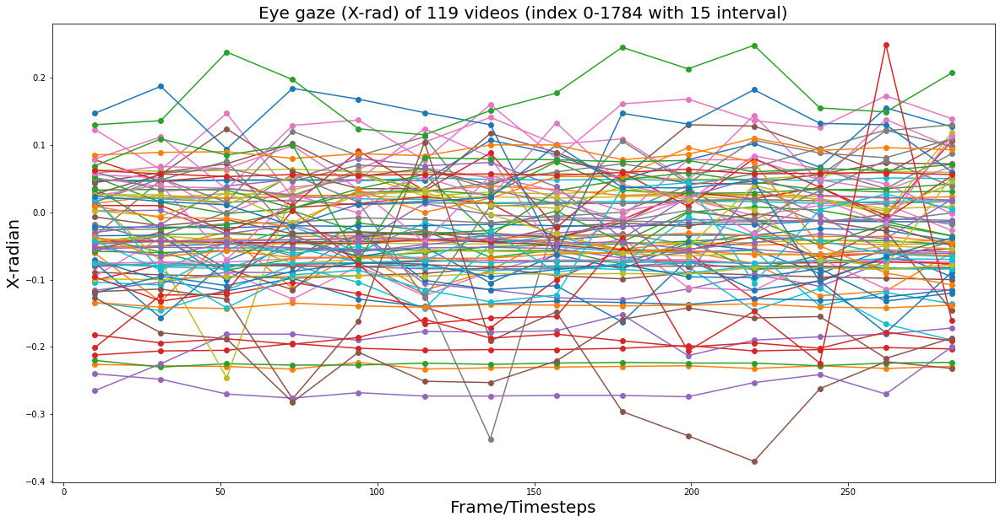

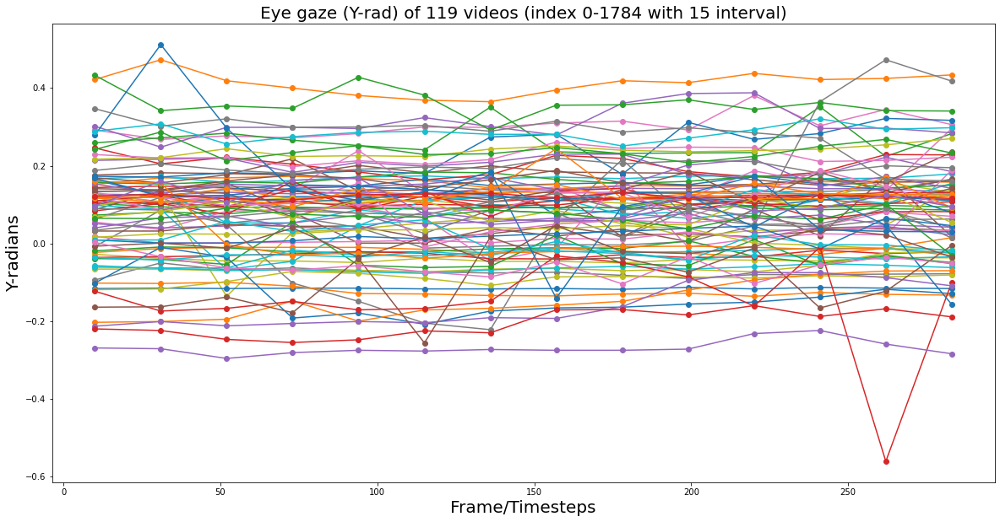

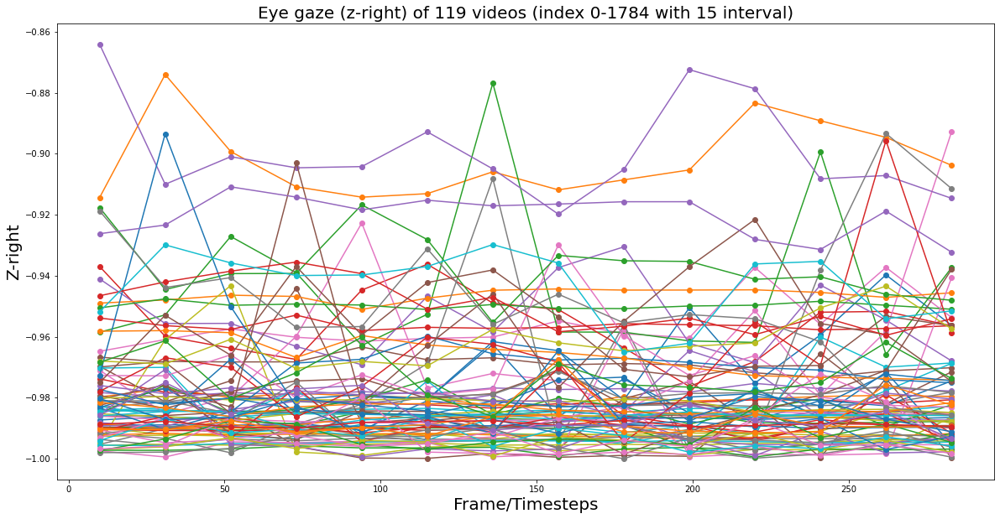

In [9]:
# Plot eye features of all videos
plt.figure(figsize=(20,10))
for i in idx_all:
    plt.plot(df_feat.frame[9:300:21],X_test_eye1[i,:,0],'-o')
plt.title("Eye gaze (X-rad) of 119 videos (index 0-1784 with 15 interval)", fontsize=20)
plt.ylabel("X-radian", fontsize=20)
plt.xlabel("Frame/Timesteps", fontsize=20)
plt.show()

plt.figure(figsize=(20,10))
for i in idx_all:
    plt.plot(df_feat.frame[9:300:21],X_test_eye1[i,:,1],'-o')
plt.title("Eye gaze (Y-rad) of 119 videos (index 0-1784 with 15 interval)", fontsize=20)
plt.ylabel("Y-radians", fontsize=20)
plt.xlabel("Frame/Timesteps", fontsize=20)
plt.show()

plt.figure(figsize=(20,10))
for i in idx_all:
    plt.plot(df_feat.frame[9:300:21],X_test_eye1[i,:,2],'-o')
plt.title("Eye gaze (z-right) of 119 videos (index 0-1784 with 15 interval)", fontsize=20)
plt.ylabel("Z-right", fontsize=20)
plt.xlabel("Frame/Timesteps", fontsize=20)
plt.show()

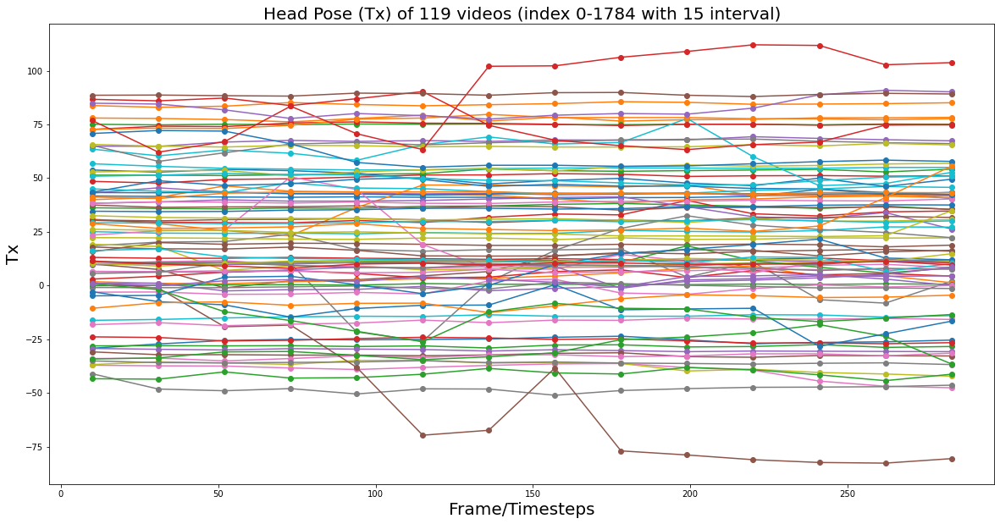

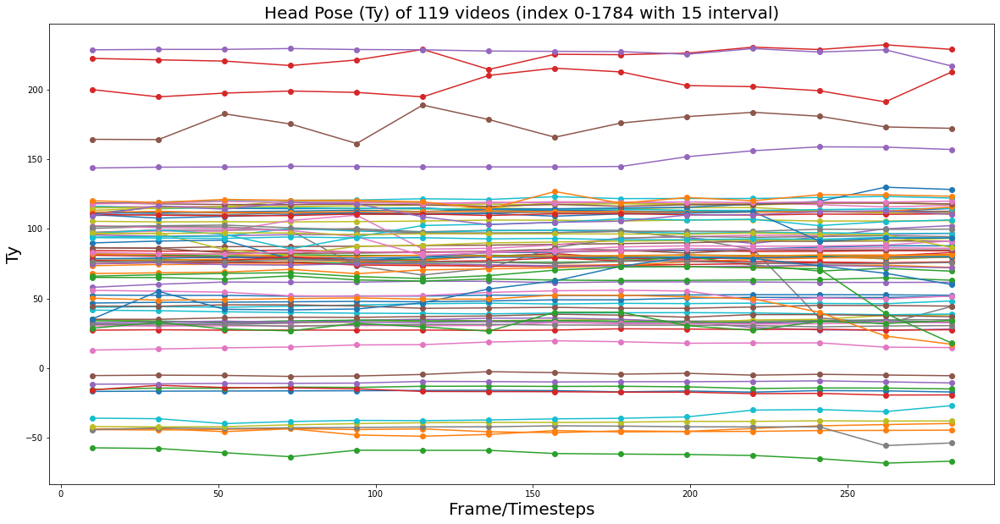

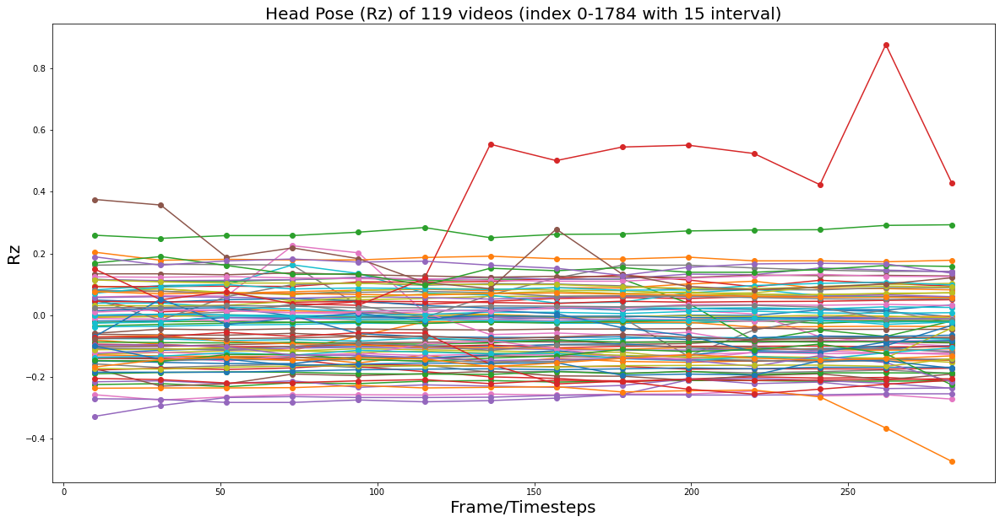

In [10]:
# Plot Head Pose features of all videos
plt.figure(figsize=(20,10))
for i in idx_all:
    plt.plot(df_feat.frame[9:300:21],X_test_head[i,:,0],'-o')
plt.title("Head Pose (Tx) of 119 videos (index 0-1784 with 15 interval)", fontsize=20)
plt.ylabel("Tx", fontsize=20)
plt.xlabel("Frame/Timesteps", fontsize=20)
plt.show()

plt.figure(figsize=(20,10))
for i in idx_all:
    plt.plot(df_feat.frame[9:300:21],X_test_head[i,:,1],'-o')
plt.title("Head Pose (Ty) of 119 videos (index 0-1784 with 15 interval)", fontsize=20)
plt.ylabel("Ty", fontsize=20)
plt.xlabel("Frame/Timesteps", fontsize=20)
plt.show()

plt.figure(figsize=(20,10))
for i in idx_all:
    plt.plot(df_feat.frame[9:300:21],X_test_head[i,:,2],'-o')
plt.title("Head Pose (Rz) of 119 videos (index 0-1784 with 15 interval)", fontsize=20)
plt.ylabel("Rz", fontsize=20)
plt.xlabel("Frame/Timesteps", fontsize=20)
plt.show()

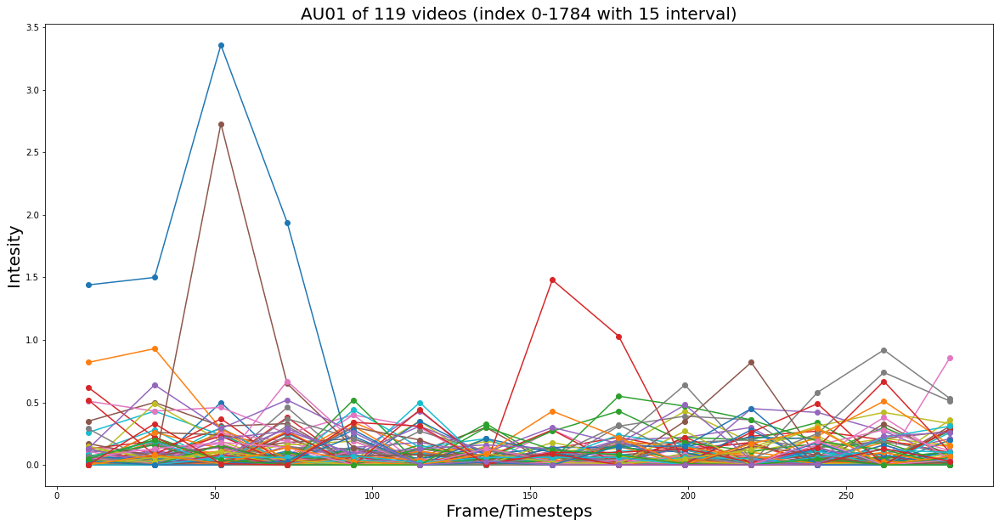

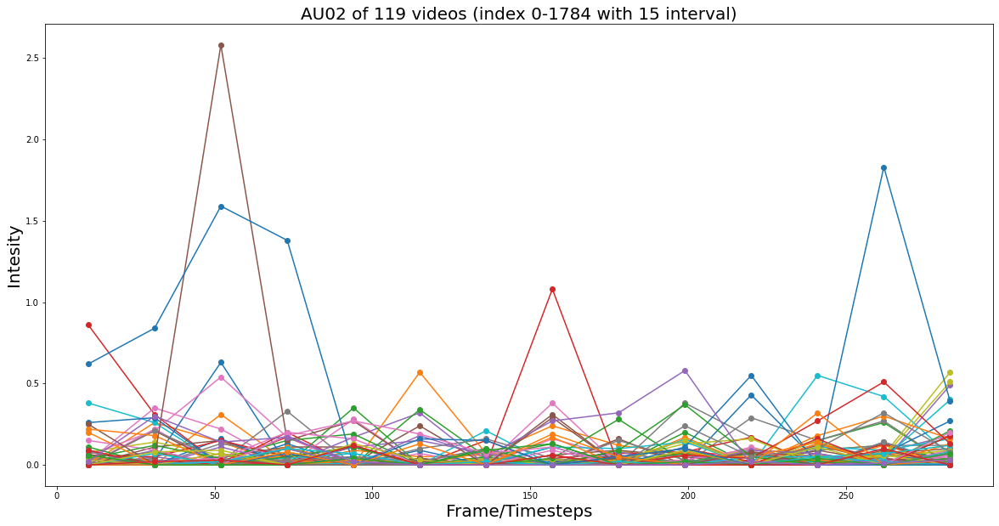

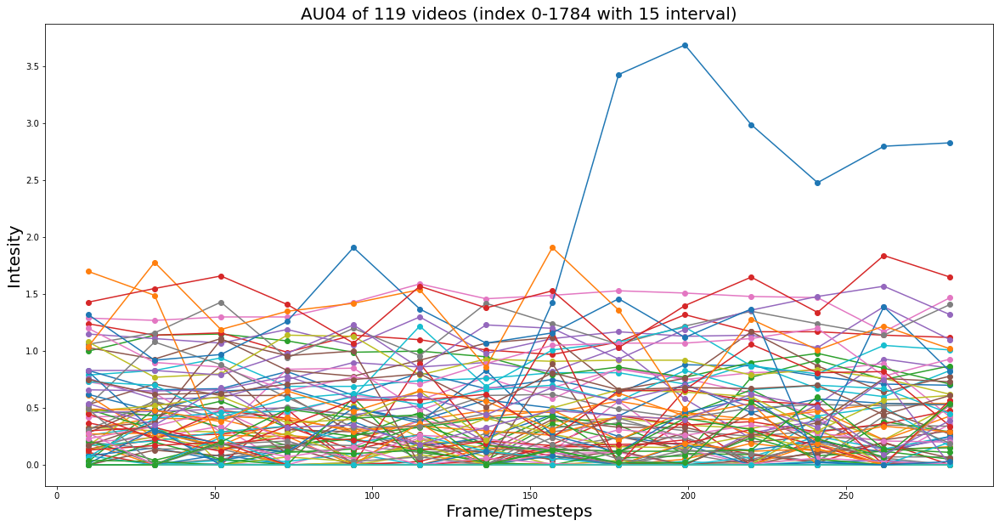

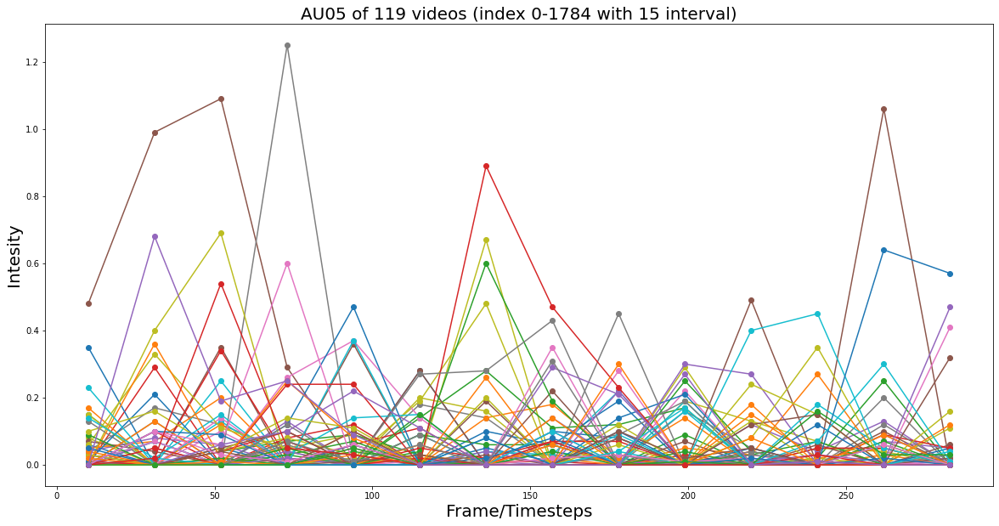

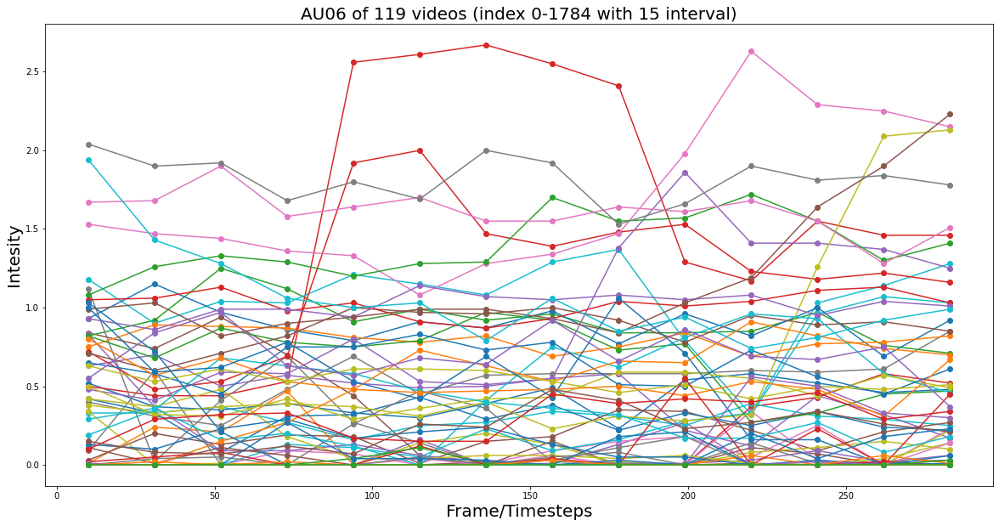

...

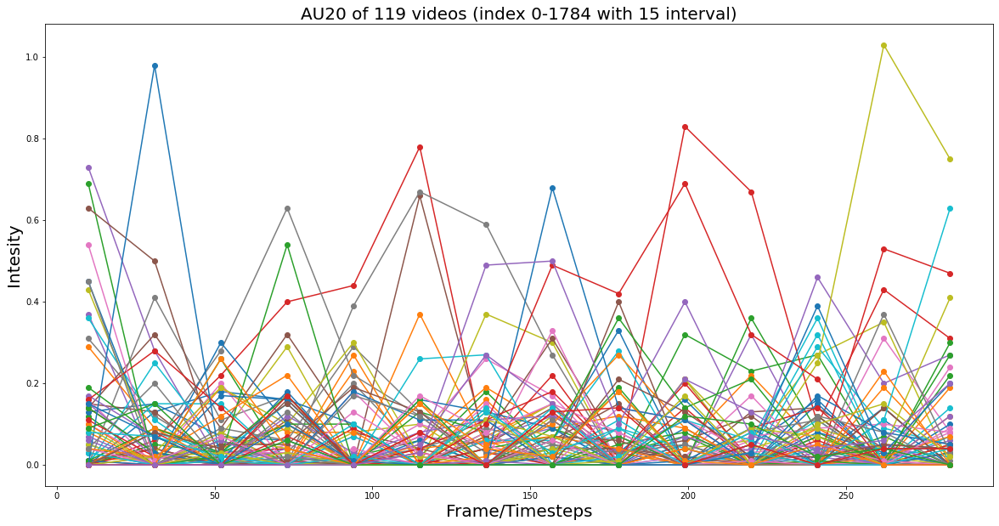

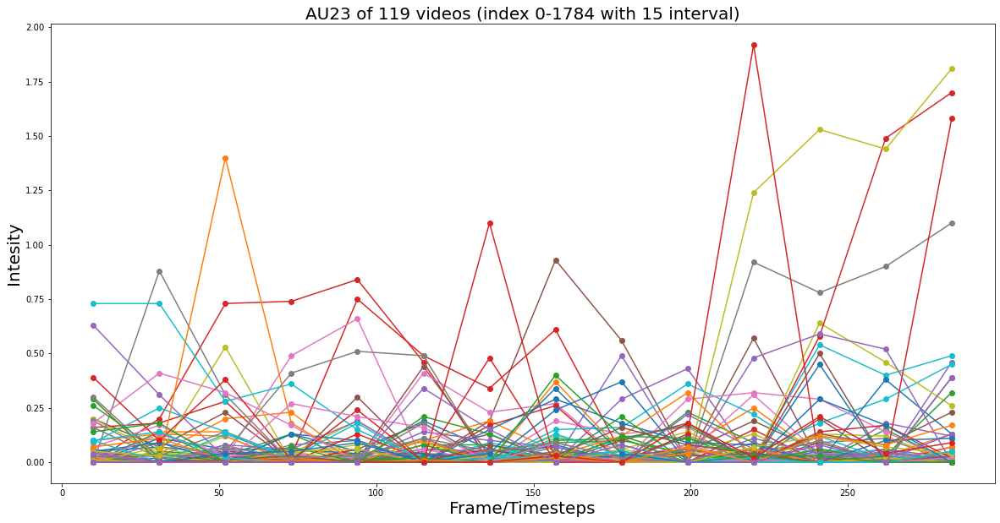

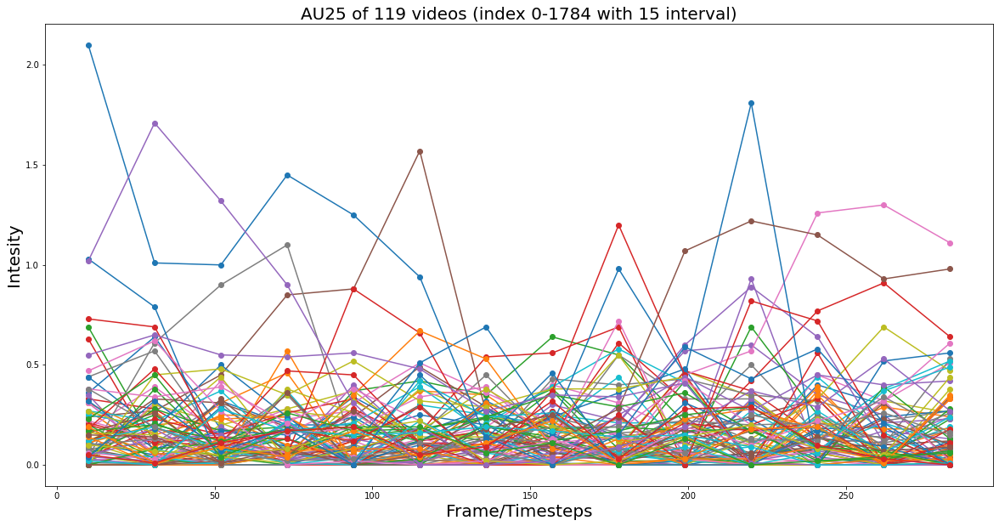

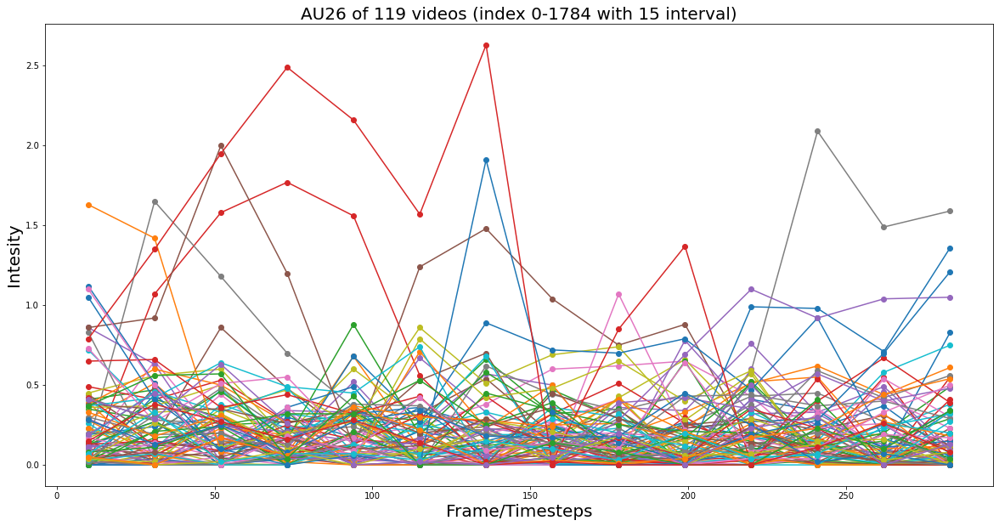

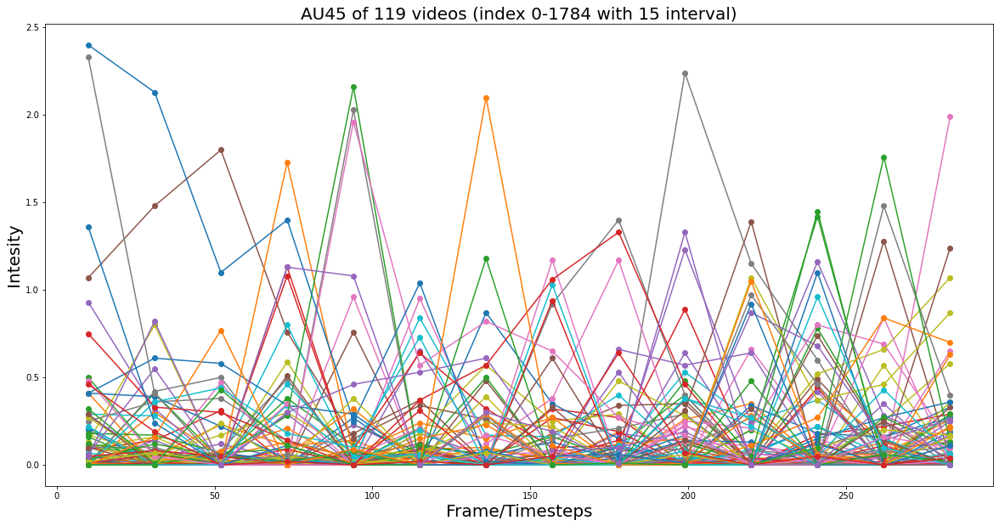

In [11]:
# Plot Head Pose features of all videos
AU = ["AU01", "AU02", "AU04", "AU05", "AU06", "AU07", "AU09", "AU10", "AU12", "AU14", "AU15", "AU17", "AU20", "AU23", "AU25", "AU26", "AU45"]

for y in list(range(len(AU))):
    plt.figure(figsize=(20,10))
    for i in idx_all:
        plt.plot(df_feat.frame[9:300:21],X_test_au[i,:,y],'-o')
    plt.title("{} of 119 videos (index 0-1784 with 15 interval)".format(AU[y]), fontsize=20)
    plt.ylabel("Intesity", fontsize=20)
    plt.xlabel("Frame/Timesteps", fontsize=20)
    plt.show()


### Statistical description

In [12]:
def all_concat(eyegaze,headpose):
    # Eye Gaze
    all_x_rad = []
    all_y_rad = []
    all_z_right = []
    # Head Pose
    all_Tx = []
    all_Ty = []
    all_Rz = []

    for i in list(range(len(eyegaze))):
        all_x_rad = np.concatenate([all_x_rad, eyegaze[i,:,0]])
        all_y_rad = np.concatenate([all_y_rad, eyegaze[i,:,1]])
        all_z_right = np.concatenate([all_z_right, eyegaze[i,:,2]])
        all_Tx = np.concatenate([all_Tx, headpose[i,:,0]])
        all_Ty = np.concatenate([all_Ty, headpose[i,:,1]])
        all_Rz = np.concatenate([all_Rz, headpose[i,:,2]])

    print("Stats_X_Rad:\n{}".format(stats.describe(all_x_rad)))
    print("stats_y_rad:\n{}".format(stats.describe(all_y_rad)))
    print("stats_z_right:\n{}".format(stats.describe(all_z_right)))
    print("stats_Tx:\n{}".format(stats.describe(all_Tx)))
    print("stats_Ty:\n{}".format(stats.describe(all_Ty)))
    print("Stats_Rz:\n{}".format(stats.describe(all_Rz)))

    return all_x_rad, all_y_rad, all_z_right, all_Tx, all_Ty, all_Rz

In [13]:
tic = datetime.now()
all_train_x_rad, all_train_y_rad, all_train_z_right, all_train_Tx, all_train_Ty, all_train_Rz = all_concat(X_train_eye1,X_train_head)

all_val_x_rad, all_val_y_rad, all_val_z_right, all_val_Tx, all_val_Ty, all_val_Rz = all_concat(X_val_eye1,X_val_head)

all_test_x_rad, all_test_y_rad, all_test_z_right, all_test_Tx, all_test_Ty, all_test_Rz = all_concat(X_test_eye1,X_test_head)
print('Processing time {}'.format(time))

Stats_X_Rad:
DescribeResult(nobs=75012, minmax=(-0.719, 0.785), mean=-0.04611802111662135, variance=0.010115402596406588, skewness=0.14554326405138795, kurtosis=2.948982564306145)
stats_y_rad:
DescribeResult(nobs=75012, minmax=(-0.485, 0.729), mean=0.09738007252172985, variance=0.021073005054357434, skewness=0.2597420780500228, kurtosis=0.10613888794644799)
stats_z_right:
DescribeResult(nobs=75012, minmax=(-1.0, -0.293402), mean=-0.9701507945662027, variance=0.000881221451522047, skewness=2.2373190764883946, kurtosis=9.525560182092187)
stats_Tx:
DescribeResult(nobs=75012, minmax=(-349.0, 480.4), mean=30.274436090225564, variance=2264.635291605852, skewness=0.09288440006376684, kurtosis=5.350432362360699)
stats_Ty:
DescribeResult(nobs=75012, minmax=(-239.6, 633.7), mean=63.28134831760251, variance=3840.7323546470666, skewness=-0.028700138178365166, kurtosis=-0.004698167688232946)
Stats_Rz:
DescribeResult(nobs=75012, minmax=(-1.131, 0.915), mean=-0.02194202260971578, variance=0.011261663

NameError: name 'time' is not defined

In [14]:
def plot_stats(alldata):
    fig, ax = plt.subplots(figsize=(20,10)) #all_test_Tx,all_test_Ty, ,'HeadPose(Tx)','HeadPose(Ty)'
    ax.boxplot((alldata),
    vert=True, 
    showmeans=True, 
    meanline=True, 
    labels=('EyeGaze(X-rad)','EyeGaze(Y-rad)','EyeGaze(Z-right)','HeadPose(Tx)','HeadPose(Ty)',
'HeadPose(Rz)'),
    # patch_artist=True, 
    medianprops={'linewidth': 2,'color': 'purple'}, 
    meanprops={'linewidth': 2,'color': 'red'})
    plt.xticks(fontsize=20)
    plt.xlabel('Features', fontsize=20)
    plt.title('Statisctical Description of Each Feature (after remove 2 files)', fontsize=20)
    plt.show

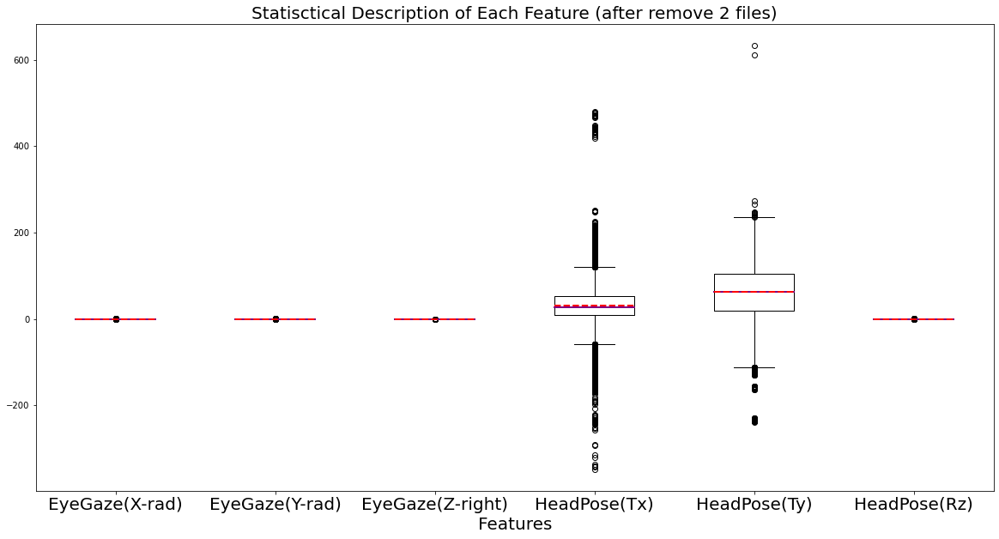

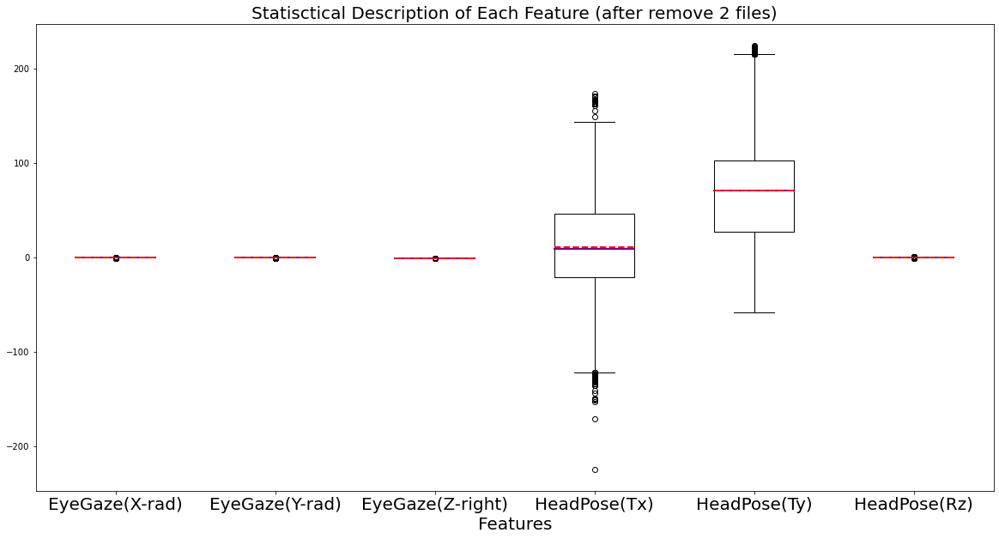

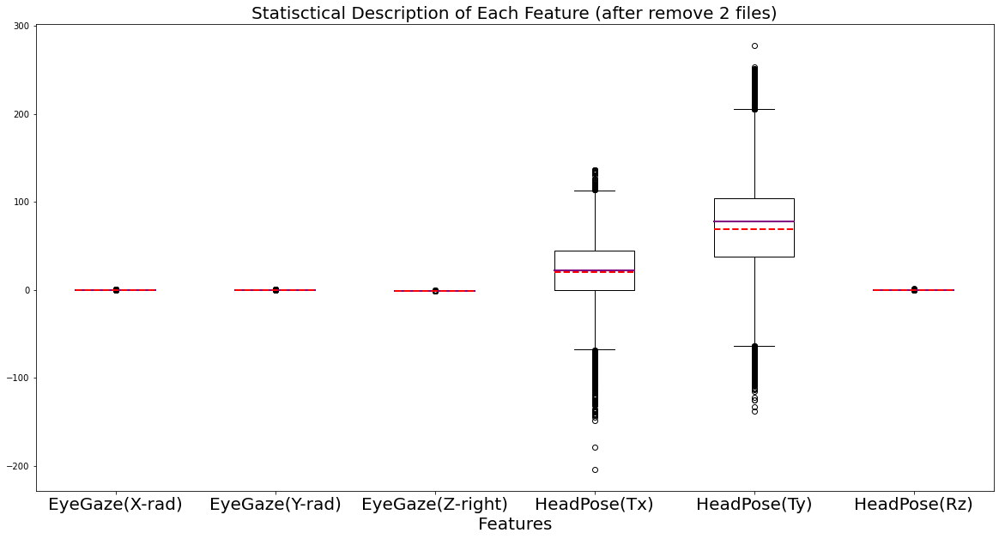

In [15]:
plot_stats([all_train_x_rad,all_train_y_rad,all_train_z_right,all_train_Tx,all_train_Ty,all_train_Rz])
plot_stats([all_val_x_rad,all_val_y_rad,all_val_z_right,all_val_Tx,all_val_Ty,all_val_Rz])
plot_stats([all_test_x_rad,all_test_y_rad,all_test_z_right,all_test_Tx,all_test_Ty,all_test_Rz])

In [16]:
# Eye Gaze
all_test_x_rad = []
all_test_y_rad = []
all_test_z_right = []
# Head Pose
all_test_Tx = []
all_test_Ty = []
all_test_Rz = []

for i in list(range(len(X_test_eye1))):
    all_test_x_rad = np.concatenate([all_test_x_rad, X_test_eye1[i,:,0]])
    all_test_y_rad = np.concatenate([all_test_y_rad, X_test_eye1[i,:,1]])
    all_test_z_right = np.concatenate([all_test_z_right, X_test_eye1[i,:,2]])
    all_test_Tx = np.concatenate([all_test_Tx, X_test_head[i,:,0]])
    all_test_Ty = np.concatenate([all_test_Ty, X_test_head[i,:,1]])
    all_test_Rz = np.concatenate([all_test_Rz, X_test_head[i,:,2]])

print("Stats_X_Rad:\n{}".format(stats.describe(all_test_x_rad)))
print("stats_y_rad:\n{}".format(stats.describe(all_test_y_rad)))
print("stats_z_right:\n{}".format(stats.describe(all_test_z_right)))
print("stats_Tx:\n{}".format(stats.describe(all_test_Tx)))
print("stats_Ty:\n{}".format(stats.describe(all_test_Ty)))
print("Stats_Rz:\n{}".format(stats.describe(all_test_Rz)))

Stats_X_Rad:
DescribeResult(nobs=24948, minmax=(-0.587, 0.775), mean=-0.027376102292768958, variance=0.008522139577191123, skewness=0.05048780745223509, kurtosis=2.319838288734533)
stats_y_rad:
DescribeResult(nobs=24948, minmax=(-0.561, 0.647), mean=0.08203655603655603, variance=0.017633882176650285, skewness=-0.10918239367101096, kurtosis=0.2705715465333438)
stats_z_right:
DescribeResult(nobs=24948, minmax=(-0.999996, -0.732072), mean=-0.9768540855780022, variance=0.0004615723374622316, skewness=2.2373507327909423, kurtosis=8.847451417186655)
stats_Tx:
DescribeResult(nobs=24948, minmax=(-204.3, 136.4), mean=20.383938592271925, variance=1323.1229901067836, skewness=-0.40192127425707924, kurtosis=0.5166431667955438)
stats_Ty:
DescribeResult(nobs=24948, minmax=(-138.2, 277.9), mean=68.86954465287799, variance=2819.417744018409, skewness=-0.2158817584563854, kurtosis=0.8992078311837117)
Stats_Rz:
DescribeResult(nobs=24948, minmax=(-0.664, 1.765), mean=-0.03522005772005772, variance=0.0176

In [17]:
print(min(all_test_Tx))
print(np.argmin(all_test_Ty))
print(np.argmin(all_test_Tx))

-204.3
18332
18230


In [18]:
print(min(all_test_Tx))
print(np.where(X_test_head == min(all_test_Tx)))

print(min(all_test_Ty))
print(np.where(X_test_head == min(all_test_Ty)))

-204.3
(array([1302], dtype=int64), array([2], dtype=int64), array([0], dtype=int64))
-138.2
(array([1309], dtype=int64), array([6], dtype=int64), array([1], dtype=int64))


In [19]:
df = pd.read_csv(path+'labels/TestLabels.csv')
print(df.loc[[1316,1608],'ClipID'])
# print(df.loc[,'ClipID']) #min Tx
# print(df.loc[0,'ClipID'])

1316     826412013.csv
1608    9289010275.csv
Name: ClipID, dtype: object


In [23]:
# Head Pose
all_test_Tx_ = []
all_test_Ty_ = []

for i in list(range(len(X_test_head_))):
    all_test_Tx_ = np.concatenate([all_test_Tx_, X_test_head_[i,:,0]])
    all_test_Ty_ = np.concatenate([all_test_Ty_, X_test_head_[i,:,1]])

print("stats_Tx_:\n{}".format(stats.describe(all_test_Tx_)))
print("stats_Ty_:\n{}".format(stats.describe(all_test_Ty_)))


In [ ]:
fig, ax = plt.subplots(figsize=(20,10)) 
ax.boxplot((all_test_Tx_,all_test_Ty_),
vert=True, 
showmeans=True, 
meanline=True, 
labels=('HeadPose(Tx)','HeadPose(Ty)'),
# patch_artist=True, 
medianprops={'linewidth': 2,'color': 'purple'}, 
meanprops={'linewidth': 2,'color': 'red'})
plt.xticks(fontsize=20)
plt.xlabel('Features', fontsize=20)
plt.title('Statisctical Description of Each Feature', fontsize=20)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

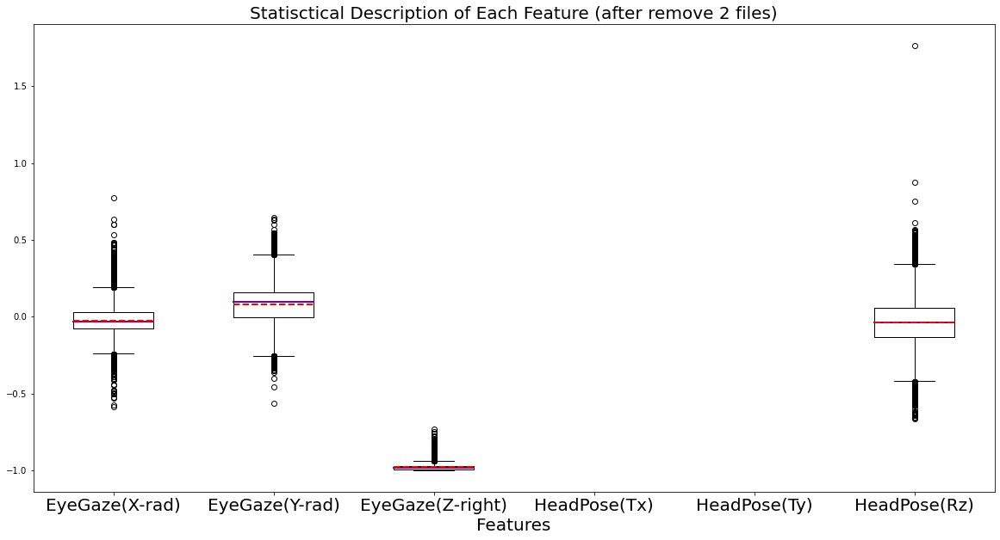

In [25]:
fig, ax = plt.subplots(figsize=(20,10)) #all_test_Tx,all_test_Ty, ,'HeadPose(Tx)','HeadPose(Ty)'
ax.boxplot((all_test_x_rad,all_test_y_rad,all_test_z_right,all_test_Tx_,all_test_Ty_,all_test_Rz),
vert=True, 
showmeans=True, 
meanline=True, 
labels=('EyeGaze(X-rad)','EyeGaze(Y-rad)','EyeGaze(Z-right)','HeadPose(Tx)','HeadPose(Ty)','HeadPose(Rz)'),
# patch_artist=True, 
medianprops={'linewidth': 2,'color': 'purple'}, 
meanprops={'linewidth': 2,'color': 'red'})
plt.xticks(fontsize=20)
plt.xlabel('Features', fontsize=20)
plt.title('Statisctical Description of Each Feature (after remove 2 files)', fontsize=20)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

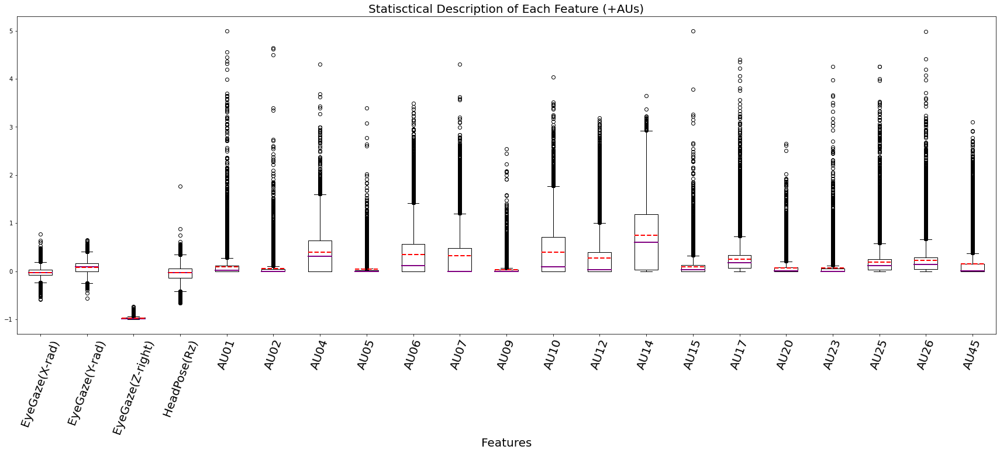

In [24]:
AU = ["AU01", "AU02", "AU04", "AU05", "AU06", "AU07", "AU09", "AU10", "AU12", "AU14", "AU15", "AU17", "AU20", "AU23", "AU25", "AU26", "AU45"]

for au in AU: # create variable concatenated AU
    globals()['all_%s' % au] = []

for i in list(range(len(X_test_eye1))):
    all_AU01 = np.concatenate([all_AU01,X_test_au[i,:,0]])
    all_AU02 = np.concatenate([all_AU02,X_test_au[i,:,1]])
    all_AU04 = np.concatenate([all_AU04,X_test_au[i,:,2]])
    all_AU05 = np.concatenate([all_AU05,X_test_au[i,:,3]])
    all_AU06 = np.concatenate([all_AU06,X_test_au[i,:,4]])
    all_AU07 = np.concatenate([all_AU07,X_test_au[i,:,5]])
    all_AU09 = np.concatenate([all_AU09,X_test_au[i,:,6]])
    all_AU10 = np.concatenate([all_AU10,X_test_au[i,:,7]])
    all_AU12 = np.concatenate([all_AU12,X_test_au[i,:,8]])
    all_AU14 = np.concatenate([all_AU14,X_test_au[i,:,9]])
    all_AU15 = np.concatenate([all_AU15,X_test_au[i,:,10]])
    all_AU17 = np.concatenate([all_AU17,X_test_au[i,:,11]])
    all_AU20 = np.concatenate([all_AU20,X_test_au[i,:,12]])
    all_AU23 = np.concatenate([all_AU23,X_test_au[i,:,13]])
    all_AU25 = np.concatenate([all_AU25,X_test_au[i,:,14]])
    all_AU26 = np.concatenate([all_AU26,X_test_au[i,:,15]])
    all_AU45 = np.concatenate([all_AU45,X_test_au[i,:,16]])
 
fig, ax = plt.subplots(figsize=(30,10)) 
ax.boxplot((all_test_x_rad,all_test_y_rad,all_test_z_right,all_test_Rz,all_AU01,all_AU02,all_AU04,all_AU05,all_AU06,all_AU07,all_AU09,all_AU10,all_AU12,all_AU14,all_AU15,all_AU17,all_AU20,all_AU23,all_AU25,all_AU26,all_AU45), #
vert=True, 
showmeans=True, 
meanline=True, 
labels=('EyeGaze(X-rad)','EyeGaze(Y-rad)','EyeGaze(Z-right)','HeadPose(Rz)',"AU01", "AU02", "AU04", "AU05", "AU06", "AU07", "AU09", "AU10", "AU12", "AU14", "AU15", "AU17", "AU20", "AU23", "AU25", "AU26", "AU45"), #
# patch_artist=True, 
medianprops={'linewidth': 2,'color': 'purple'}, 
meanprops={'linewidth': 2,'color': 'red'})
plt.xticks(rotation=70,fontsize=20)
plt.xlabel('Features', fontsize=20)
plt.title('Statisctical Description of Each Feature (+AUs)', fontsize=20)
plt.show

ipykernel_launcher:5: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
ipykernel_launcher:6: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later


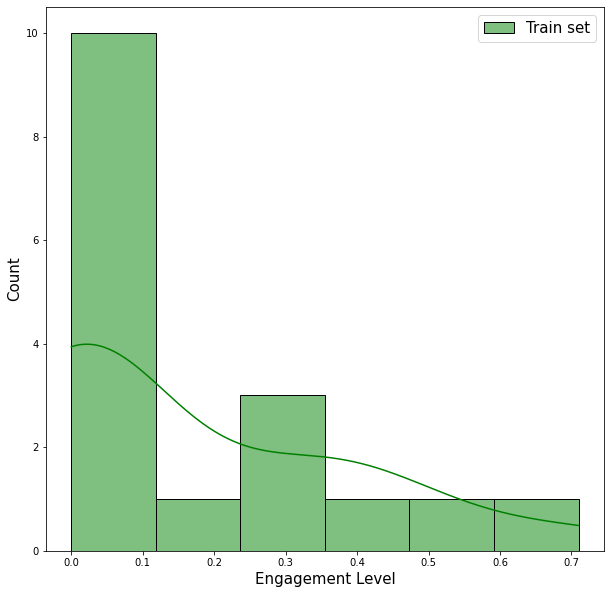

In [26]:
plt.figure(figsize=(10, 10))
sns.histplot(x=X_train_au[0,1,:], color="green", label="Train set", kde=True)
# sns.histplot(x=Y_val_head, color="red", label="Validation set", kde=True)
# sns.histplot(x=Y_test_head, color="skyblue", label="Test set", kde=True)
plt.xlabel("Engagement Level", Fontsize=15)
plt.ylabel("Count",Fontsize=15)
plt.legend(fontsize=15) 
plt.show()

ipykernel_launcher:10: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
ipykernel_launcher:11: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later


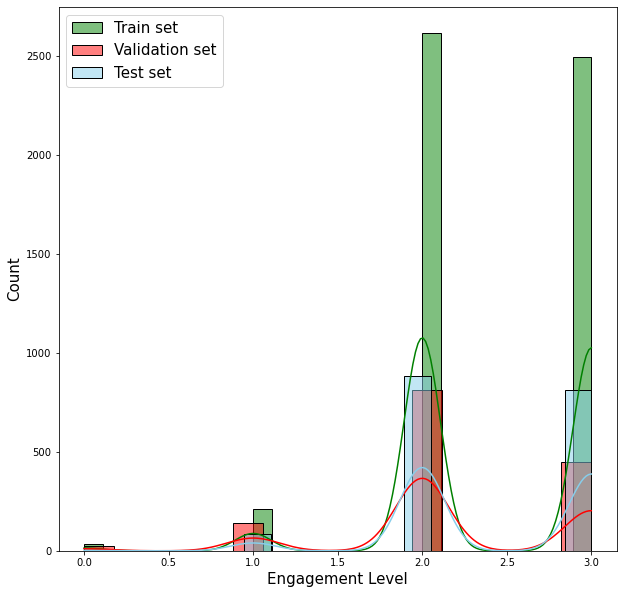

In [27]:
# sns.histplot(x=Y_test_head, hist=False, rug=True)
# sns.histplot(x=Y_val_head)
# # sns.histplot(x=X_train_head)
# plt.show()

plt.figure(figsize=(10, 10))
sns.histplot(x=Y_train_head, color="green", label="Train set", kde=True)
sns.histplot(x=Y_val_head, color="red", label="Validation set", kde=True)
sns.histplot(x=Y_test_head, color="skyblue", label="Test set", kde=True)
plt.xlabel("Engagement Level", Fontsize=15)
plt.ylabel("Count",Fontsize=15)
plt.legend(fontsize=15) 
plt.show()

### Pre-process EMOTIW2018


In [121]:
import glob

path = ('C:/Users/hasegawa-lab-pc/OneDrive - Japan Advanced Institute of Science and Technology/Documents/Dataset/EmotiW/Engagement recognition/')

def load_emotiw2018(datapath,colnum):
    data_list = []
    for filename in glob.glob(path+datapath):
        print(filename)
        temp_df = pd.read_csv(filename)
        # temp_df = temp_df.iloc[9:300:21,colnum] #take 1 every 21 frame   
        temp_df = temp_df.groupby(np.arange(len(temp_df))//30).mean() #average every 30 frames, resulting 10 timesteps
        temp_df = temp_df.iloc[:,colnum] #select features 
    
        temp_df = np.array(temp_df)
        data_list.append(temp_df)
    
    X = np.array(data_list)
    print('X shape:{}'.format(X.shape))

    return X


In [160]:
tic = datetime.now()
X_train_eye_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/Train/*.txt',[7,8,9])
X_val_eye_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/validation/*.txt',[7,8,9])
X_test_eye_emotiw = load_emotiw2018('Test/Open_face_output/*.txt',[7,8,9])

X_train_head_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/Train/*.txt',[10,11,15])
X_val_head_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/validation/*.txt',[10,11,15])
X_test_head_emotiw = load_emotiw2018('Test/Open_face_output/*.txt',[10,11,15])

# 3. AUs7 intesity (col 299-315)
AUi_index = list(range(396,412))
X_train_au_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/Train/*.txt',AUi_index)
X_val_au_emotiw = load_emotiw2018('01. Train and validation/OpenFace_features/validation/*.txt',AUi_index)
X_test_au_emotiw = load_emotiw2018('Test/Open_face_output/*.txt',AUi_index)

time = datetime.now() - tic
print('Processing time {}'.format(time))

C:\Users\hasegawa-lab-pc\miniconda3\envs\tf2.1\lib\site-packages\IPython\core\interactiveshell.py:3357: DtypeWarning: Columns (10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250

In [1]:
# df = pd.read_csv('C:/Users/hasegawa-lab-pc/OneDrive - Japan Advanced Institute of Science and Technology/Documents/Dataset/EmotiW/Engagement recognition/Test/Open_face_output/test_11.txt')
# print(df)

# for num, col_name in enumerate(df.columns): 
#     print(num,col_name)

In [93]:
with open('eye_emotiw.pkl','wb') as f:
    pickle.dump([X_train_eye_emotiw, X_val_eye_emotiw, X_test_eye_emotiw], f)


with open('head_emotiw.pkl', 'wb') as f:
    pickle.dump([X_train_head_emotiw, X_val_head_emotiw,X_test_head_emotiw],f)

with open('au_emotiw.pkl','wb') as f:
    pickle.dump([X_train_au_emotiw, X_val_au_emotiw,X_test_au_emotiw],f)